In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

In [2]:
#read csv - music all genre 
genre = pd.read_csv('music_genre.csv')
genre

,song_id,artist_names,artists_id,danceability,energy,valence,tempo,loudness,mode,key,...,instrumentalness,liveness,speechiness,explicit,duration_ms,popularity,year,release_date,song_title,Genre
0,0,"[""Fat Freddy's Drop""]",[178301],0.600,0.365,0.131,130.046,-13.083,0,9,...,0.585000,0.0921,0.0498,0,437200,54,2005,2005,Ernie,Electronic
1,1,"[""Fat Freddy's Drop""]",[178301],0.874,0.326,0.179,119.620,-13.302,0,11,...,0.148000,0.0993,0.1310,0,581008,53,2005,2005,Wandering Eye,Electronic
2,2,"[""Fat Freddy's Drop""]",[178301],0.670,0.531,0.336,139.385,-8.267,0,9,...,0.345000,0.3060,0.0377,0,431293,55,2009,8/7/2009,The Raft,Electronic
3,3,"[""Alexander O'Neal""]",[625201],0.761,0.702,0.850,104.773,-8.523,1,7,...,0.000031,0.0935,0.0389,0,304427,34,1991,1/1/1991,All True Man,R&B;
4,4,"[""Alexander O'Neal""]",[625201],0.661,0.828,0.902,115.078,-12.673,0,11,...,0.000001,0.2870,0.0390,0,264933,37,1987,7/29/1987,(What Can I Say) To Make You Love Me,R&B;
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99458,99458,['ZZ Top'],[690254],0.276,0.892,0.715,80.475,-7.035,1,11,...,0.000000,0.7140,0.0893,0,115973,33,1975,4/18/1975,Jailhouse Rock - **** Remaster,Pop/Rock
99459,99459,['ZZ Top'],[690254],0.700,0.592,0.906,109.847,-10.434,1,11,...,0.018400,0.1180,0.0681,0,263627,32,1976,11/29/1976,It's Only Love,Pop/Rock
99460,99460,['ZZ Top'],[690254],0.709,0.709,0.863,111.544,-12.023,1,2,...,0.000011,0.1250,0.0370,0,158400,31,1987,1987,Balinese,Pop/Rock
99461,99461,['ZZ Top'],[690254],0.552,0.651,0.533,161.548,-10.624,0,4,...,0.034900,0.1320,0.2290,0,232533,43,1992,4/13/1992,La Grange - **** Remaster,Pop/Rock


In [3]:
#drop 'song_id' column and add "decade" column, remove [] bracket from ['artist_names'] and ['artists_id']
genre = genre.drop(['song_id'],axis = 1)
genre = genre.assign(decade = lambda x: (x.year//10)*10)
genre['artist_names'] =  genre['artist_names'].apply(lambda x: x.replace('[','').replace(']','')) 
genre['artists_id'] =  genre['artists_id'].apply(lambda x: x.replace('[','').replace(']','')) 
genre

,artist_names,artists_id,danceability,energy,valence,tempo,loudness,mode,key,acousticness,...,liveness,speechiness,explicit,duration_ms,popularity,year,release_date,song_title,Genre,decade
0,"""Fat Freddy's Drop""",178301,0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,...,0.0921,0.0498,0,437200,54,2005,2005,Ernie,Electronic,2000
1,"""Fat Freddy's Drop""",178301,0.874,0.326,0.179,119.620,-13.302,0,11,0.01360,...,0.0993,0.1310,0,581008,53,2005,2005,Wandering Eye,Electronic,2000
2,"""Fat Freddy's Drop""",178301,0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,...,0.3060,0.0377,0,431293,55,2009,8/7/2009,The Raft,Electronic,2000
3,"""Alexander O'Neal""",625201,0.761,0.702,0.850,104.773,-8.523,1,7,0.10800,...,0.0935,0.0389,0,304427,34,1991,1/1/1991,All True Man,R&B;,1990
4,"""Alexander O'Neal""",625201,0.661,0.828,0.902,115.078,-12.673,0,11,0.27600,...,0.2870,0.0390,0,264933,37,1987,7/29/1987,(What Can I Say) To Make You Love Me,R&B;,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99458,'ZZ Top',690254,0.276,0.892,0.715,80.475,-7.035,1,11,0.40900,...,0.7140,0.0893,0,115973,33,1975,4/18/1975,Jailhouse Rock - **** Remaster,Pop/Rock,1970
99459,'ZZ Top',690254,0.700,0.592,0.906,109.847,-10.434,1,11,0.10800,...,0.1180,0.0681,0,263627,32,1976,11/29/1976,It's Only Love,Pop/Rock,1970
99460,'ZZ Top',690254,0.709,0.709,0.863,111.544,-12.023,1,2,0.11800,...,0.1250,0.0370,0,158400,31,1987,1987,Balinese,Pop/Rock,1980
99461,'ZZ Top',690254,0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,...,0.1320,0.2290,0,232533,43,1992,4/13/1992,La Grange - **** Remaster,Pop/Rock,1990


In [4]:
genre.describe()

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,explicit,duration_ms,popularity,year,decade
count,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,99463.000000,9.946300e+04,99463.000000,99463.000000,99463.000000
mean,0.529888,0.534036,0.535397,118.954006,-10.751529,0.722570,5.170847,0.417769,0.122328,0.207718,0.064375,0.037310,2.401123e+05,35.853232,1981.299699,1976.738988
std,0.163569,0.262747,0.256923,29.750368,4.987163,0.447733,3.509358,0.351993,0.268030,0.188137,0.077195,0.189522,1.098591e+05,17.190226,19.385181,19.642240
min,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.108000e+03,0.000000,1921.000000,1920.000000
25%,0.420000,0.321000,0.329000,96.341000,-13.569000,0.000000,2.000000,0.059600,0.000000,0.095500,0.033300,0.000000,1.764670e+05,24.000000,1966.000000,1960.000000
50%,0.538000,0.537000,0.544000,116.960000,-10.151000,1.000000,5.000000,0.358000,0.000169,0.131000,0.041600,0.000000,2.202670e+05,36.000000,1980.000000,1980.000000
75%,0.647000,0.755000,0.747000,136.979500,-7.034000,1.000000,8.000000,0.765000,0.029900,0.257000,0.061600,0.000000,2.753040e+05,48.000000,1997.000000,1990.000000
max,0.985000,1.000000,1.000000,244.091000,3.744000,1.000000,11.000000,0.996000,0.999000,1.000000,0.964000,1.000000,3.816373e+06,100.000000,2020.000000,2020.000000


In [5]:
#add ['is_popular'] binary value based on popularity value of 48 higher/lower 
conditions = [
    (genre['popularity'] > 48),
    (genre['popularity'] <= 48)
]

values = ['1','0']

genre['is_popular'] = np.select(conditions, values)

genre.head()

,artist_names,artists_id,danceability,energy,valence,tempo,loudness,mode,key,acousticness,...,speechiness,explicit,duration_ms,popularity,year,release_date,song_title,Genre,decade,is_popular
0,"""Fat Freddy's Drop""",178301,0.600,0.365,0.131,130.046,-13.083,0,9,0.0672,...,0.0498,0,437200,54,2005,2005,Ernie,Electronic,2000,1
1,"""Fat Freddy's Drop""",178301,0.874,0.326,0.179,119.620,-13.302,0,11,0.0136,...,0.1310,0,581008,53,2005,2005,Wandering Eye,Electronic,2000,1
2,"""Fat Freddy's Drop""",178301,0.670,0.531,0.336,139.385,-8.267,0,9,0.0156,...,0.0377,0,431293,55,2009,8/7/2009,The Raft,Electronic,2000,1
3,"""Alexander O'Neal""",625201,0.761,0.702,0.850,104.773,-8.523,1,7,0.1080,...,0.0389,0,304427,34,1991,1/1/1991,All True Man,R&B;,1990,0
4,"""Alexander O'Neal""",625201,0.661,0.828,0.902,115.078,-12.673,0,11,0.2760,...,0.0390,0,264933,37,1987,7/29/1987,(What Can I Say) To Make You Love Me,R&B;,1980,0


In [6]:
#Standard Deviation 
sd=pd.DataFrame({'sd': np.std(genre),
                'mean': np.mean(genre)
               })
sd

,sd,mean
acousticness,0.351991,4.177688e-01
danceability,0.163568,5.298876e-01
decade,19.642142,1.976739e+03
duration_ms,109858.528053,2.401123e+05
energy,0.262746,5.340364e-01
explicit,0.189521,3.731036e-02
instrumentalness,0.268029,1.223280e-01
is_popular,NaN,inf
key,3.509341,5.170847e+00
liveness,0.188136,2.077182e-01


In [7]:
sd['three_sd_plus']=sd['mean'] + 3*sd['sd']
sd['three_sd_minus']=sd['mean'] - 3*sd['sd']
sd

,sd,mean,three_sd_plus,three_sd_minus
acousticness,0.351991,4.177688e-01,1.473742,-0.638205
danceability,0.163568,5.298876e-01,1.020592,0.039184
decade,19.642142,1.976739e+03,2035.665413,1917.812563
duration_ms,109858.528053,2.401123e+05,569687.928658,-89463.239658
energy,0.262746,5.340364e-01,1.322274,-0.254201
explicit,0.189521,3.731036e-02,0.605874,-0.531253
instrumentalness,0.268029,1.223280e-01,0.926415,-0.681759
is_popular,NaN,inf,NaN,NaN
key,3.509341,5.170847e+00,15.698869,-5.357175
liveness,0.188136,2.077182e-01,0.772127,-0.356691


In [8]:
sd = sd.drop(['decade','explicit','is_popular','key','mode','popularity','explicit','year'])


In [9]:
sd

,sd,mean,three_sd_plus,three_sd_minus
acousticness,0.351991,0.417769,1.473742,-0.638205
danceability,0.163568,0.529888,1.020592,0.039184
duration_ms,109858.528053,240112.344500,569687.928658,-89463.239658
energy,0.262746,0.534036,1.322274,-0.254201
instrumentalness,0.268029,0.122328,0.926415,-0.681759
liveness,0.188136,0.207718,0.772127,-0.356691
loudness,4.987138,-10.751529,4.209884,-25.712941
speechiness,0.077195,0.064375,0.295959,-0.167209
tempo,29.750218,118.954006,208.204661,29.703352
valence,0.256922,0.535397,1.306162,-0.235368


In [10]:
#filtered three sd
filtered_genre = genre.drop(['artists_id','release_date'],axis = 1)
for column in sd.index:
    filtered_genre = filtered_genre[(filtered_genre[column] > sd.loc[column, 'three_sd_minus']) & (filtered_genre[column] < sd.loc[column, 'three_sd_plus'])]
filtered_genre

,artist_names,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,explicit,duration_ms,popularity,year,song_title,Genre,decade,is_popular
0,"""Fat Freddy's Drop""",0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.585000,0.0921,0.0498,0,437200,54,2005,Ernie,Electronic,2000,1
2,"""Fat Freddy's Drop""",0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.345000,0.3060,0.0377,0,431293,55,2009,The Raft,Electronic,2000,1
3,"""Alexander O'Neal""",0.761,0.702,0.850,104.773,-8.523,1,7,0.10800,0.000031,0.0935,0.0389,0,304427,34,1991,All True Man,R&B;,1990,0
4,"""Alexander O'Neal""",0.661,0.828,0.902,115.078,-12.673,0,11,0.27600,0.000001,0.2870,0.0390,0,264933,37,1987,(What Can I Say) To Make You Love Me,R&B;,1980,0
5,"""Alexander O'Neal""",0.719,0.650,0.953,105.141,-12.947,0,7,0.01030,0.000044,0.1330,0.0265,0,277773,34,1987,The Lovers,R&B;,1980,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99458,'ZZ Top',0.276,0.892,0.715,80.475,-7.035,1,11,0.40900,0.000000,0.7140,0.0893,0,115973,33,1975,Jailhouse Rock - **** Remaster,Pop/Rock,1970,0
99459,'ZZ Top',0.700,0.592,0.906,109.847,-10.434,1,11,0.10800,0.018400,0.1180,0.0681,0,263627,32,1976,It's Only Love,Pop/Rock,1970,0
99460,'ZZ Top',0.709,0.709,0.863,111.544,-12.023,1,2,0.11800,0.000011,0.1250,0.0370,0,158400,31,1987,Balinese,Pop/Rock,1980,0
99461,'ZZ Top',0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.034900,0.1320,0.2290,0,232533,43,1992,La Grange - **** Remaster,Pop/Rock,1990,0


In [11]:
filtered_genre.to_csv('filtered_genre.csv', index=False)

Text(0.5, 0, 'Year')

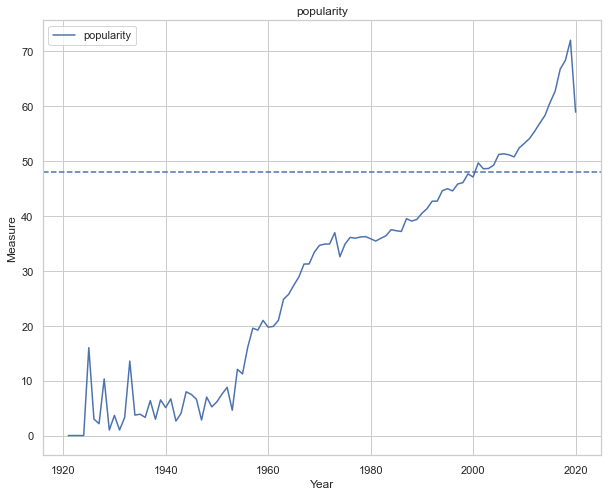

In [12]:
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
columns = ["popularity"]
for col in columns:
    x = filtered_genre.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)

ax.axhline(48, ls='--')
ax.set_title('popularity')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0.5, 0, 'Year')

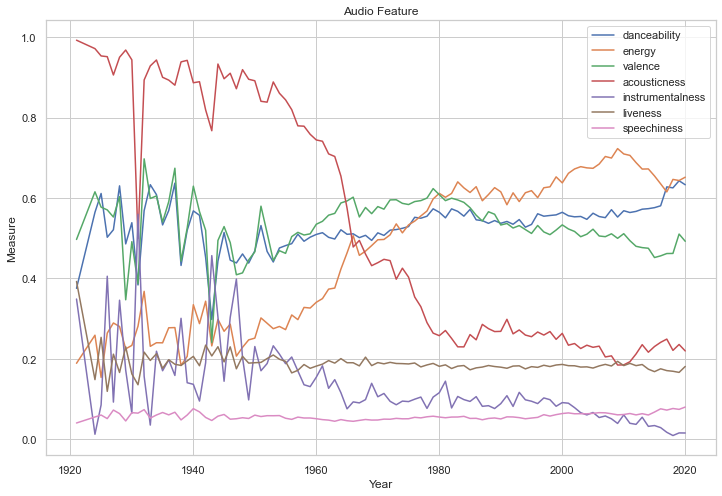

In [13]:
plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")
columns = ["danceability","energy","valence","acousticness","instrumentalness","liveness","speechiness"]
for col in columns:
    x = filtered_genre.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('Audio Feature')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0.5, 0, 'Year')

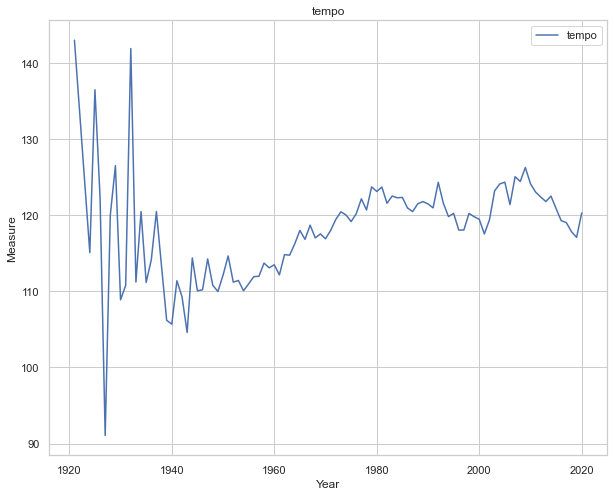

In [14]:
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
columns = ["tempo"]
for col in columns:
    x = filtered_genre.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('tempo')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0.5, 0, 'Year')

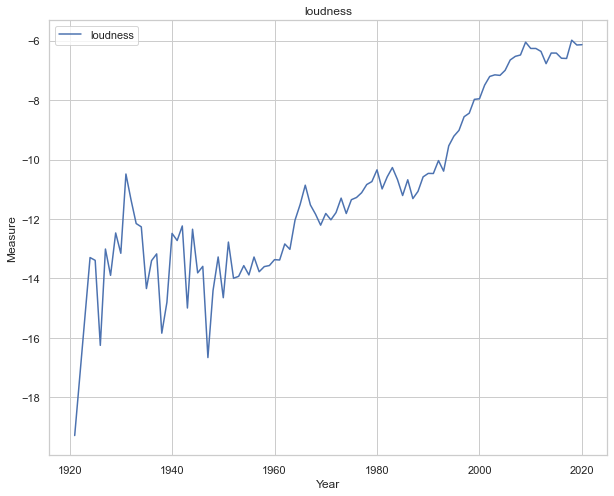

In [15]:
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
columns = ["loudness"]
for col in columns:
    x = filtered_genre.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('loudness')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000025137460DC8>,
      dtype=object)

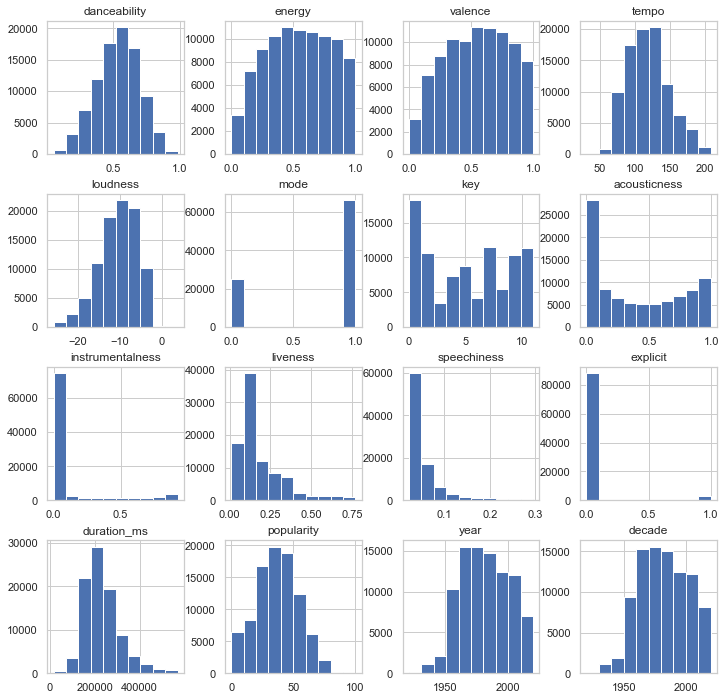

In [16]:
#hist on filtered data
filtered_genre.hist(figsize=(12,12))

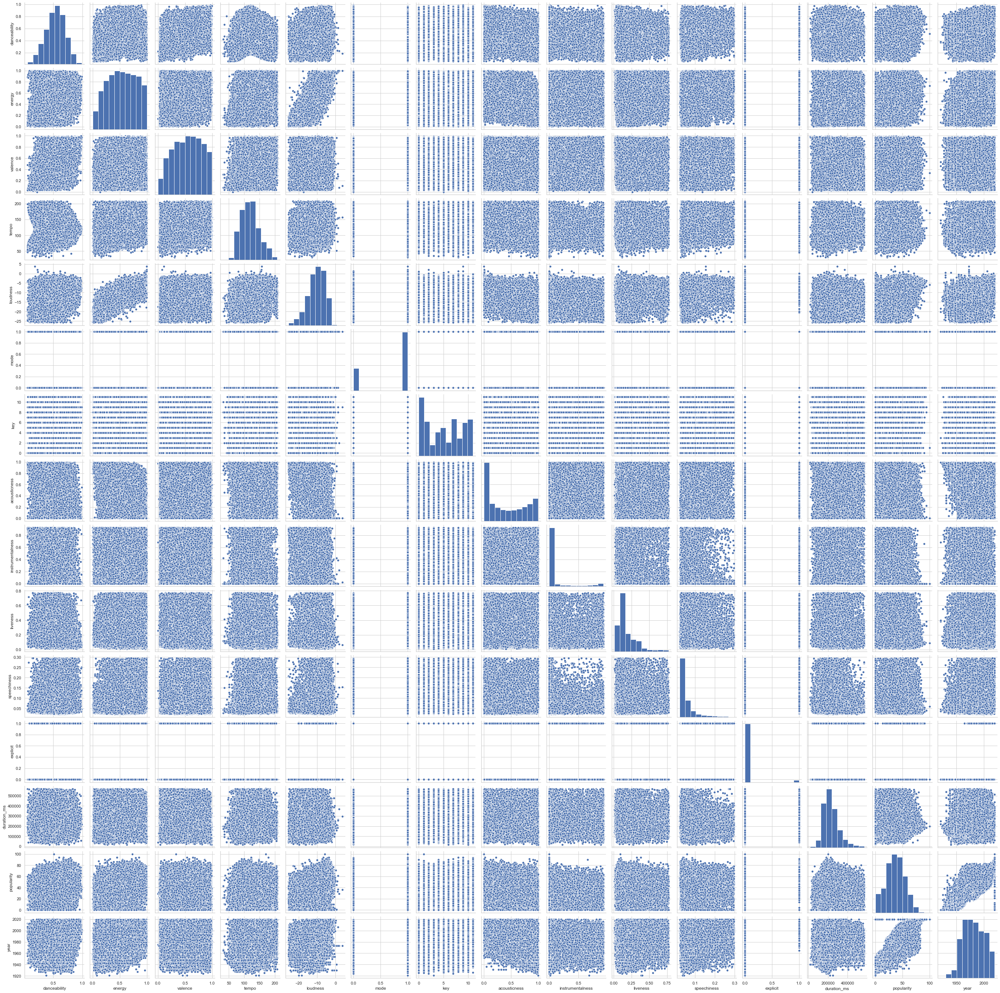

In [17]:
pp = sns.pairplot(filtered_genre.drop(columns=['artist_names','Genre','decade','is_popular','song_title']))

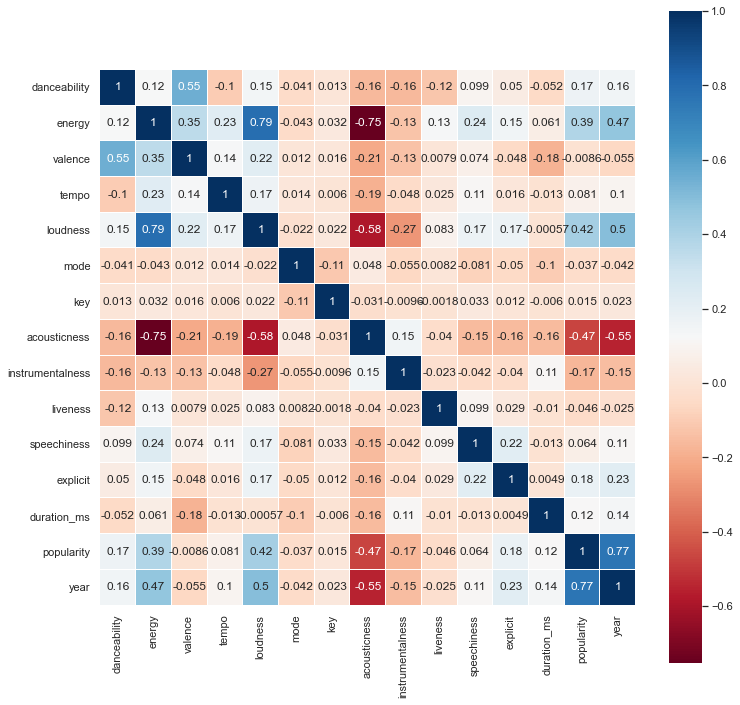

In [18]:
colormap=plt.cm.RdBu
plt.figure(figsize=(12,12))
sns.heatmap(filtered_genre.drop(columns=['artist_names','Genre','decade','is_popular','song_title']).astype(float).corr(),linewidths=0.1,cmap=colormap,vmax=1.0,square=True,annot=True)

C:\Users\yuuna\anaconda3\envs\PythonData\lib\site-packages\seaborn\categorical.py:3666: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
C:\Users\yuuna\anaconda3\envs\PythonData\lib\site-packages\seaborn\categorical.py:3672: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


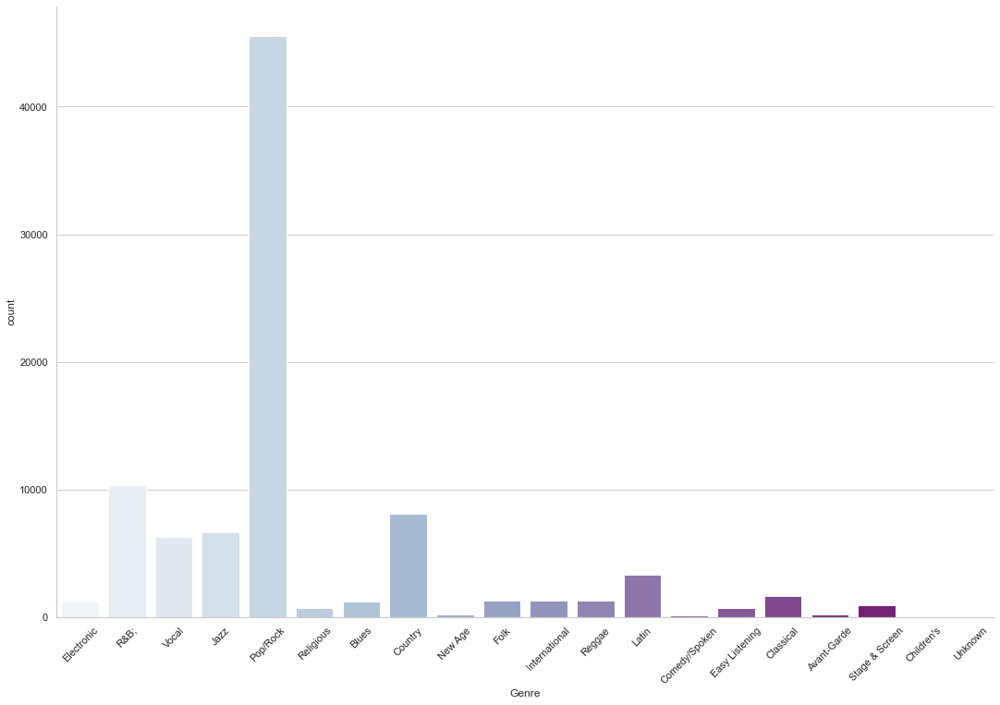

In [19]:
# plt.figure(figsize=(20,5))
genre_count = sns.factorplot(x="Genre", data=filtered_genre, kind="count",
                   palette="BuPu", size=10, aspect=1.5)
genre_count.set_xticklabels(rotation=45)

In [25]:
song_year = pd.DataFrame({'year': filtered_genre['year'],
                  'song': filtered_genre['song_title'],
                  'genre': filtered_genre['Genre']        
})
song_year

,year,song,genre
0,2005,Ernie,Electronic
2,2009,The Raft,Electronic
3,1991,All True Man,R&B;
4,1987,(What Can I Say) To Make You Love Me,R&B;
5,1987,The Lovers,R&B;
...,...,...,...
99458,1975,Jailhouse Rock - **** Remaster,Pop/Rock
99459,1976,It's Only Love,Pop/Rock
99460,1987,Balinese,Pop/Rock
99461,1992,La Grange - **** Remaster,Pop/Rock


In [26]:
song_year.groupby(['year','genre'])['song'].count().reset_index()

,year,genre,song
0,1921,Classical,2
1,1924,Jazz,1
2,1924,Vocal,1
3,1925,Jazz,1
4,1925,Vocal,2
...,...,...,...
1197,2020,Latin,71
1198,2020,Pop/Rock,228
1199,2020,R&B;,98
1200,2020,Reggae,3


In [27]:
song = song_year.drop(['genre'],axis = 1)
song = song.groupby(by='year').agg('count')
song = song.reset_index()
song

,year,song
0,1921,2
1,1924,2
2,1925,3
3,1926,2
4,1927,13
...,...,...
93,2016,610
94,2017,558
95,2018,452
96,2019,518


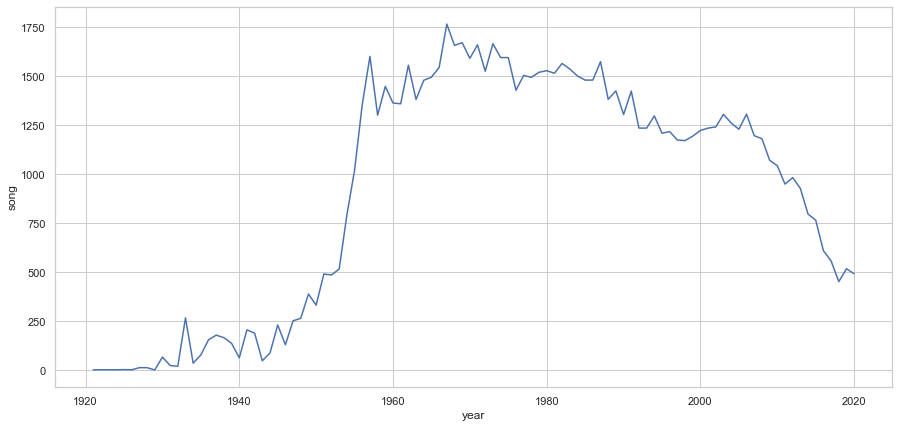

In [28]:
fig,ax=plt.subplots(figsize=(15,7))
sns.lineplot(x='year',y='song',data=song,ax=ax)

In [29]:
import plotly.express as px
fig = px.bar(song_year.groupby('year').size().diff())
fig.update_layout(title={'text': f"Increase in Songs Over Time", 'x': 0.5,
                         'xanchor': 'center', 'font': {'size': 20}}, yaxis_title="Increase", showlegend=False)
fig.show()

In [30]:
key_type = pd.DataFrame(filtered_genre["key"].value_counts())
# key_type['Tonal_Counterparts'] = key_type.index.to_series().map(key_class)
key_type = key_type.sort_index()
key_type

,key
0,12160
1,6026
2,10650
3,3436
4,7324
5,8709
6,4149
7,11518
8,5426
9,10350


C:\Users\yuuna\anaconda3\envs\PythonData\lib\site-packages\ipykernel_launcher.py:2: MatplotlibDeprecationWarning:

Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.



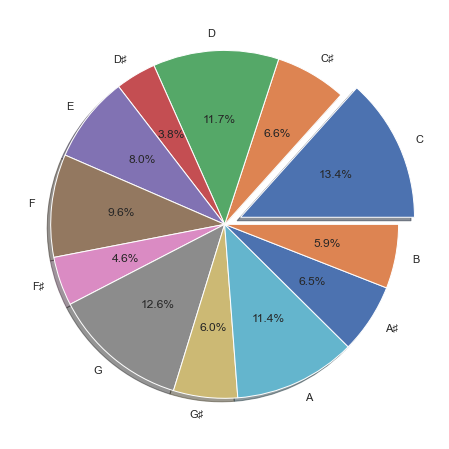

In [31]:
plt.subplots(figsize=(12, 8))
plt.pie(key_type,labels=["C", "C♯", "D", "D♯", "E", "F", "F♯", "G", "G♯", "A", "A♯", "B"],autopct='%1.1f%%',shadow=True,explode=[0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
plt.show()

In [32]:
mode = pd.DataFrame(genre["mode"].value_counts())
mode = mode.sort_index()
mode

,mode
0,27594
1,71869


C:\Users\yuuna\anaconda3\envs\PythonData\lib\site-packages\ipykernel_launcher.py:2: MatplotlibDeprecationWarning:

Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.



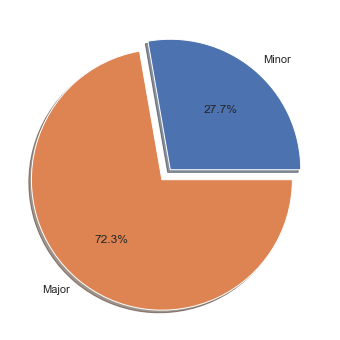

In [33]:
plt.subplots(figsize=(10, 6))
plt.pie(mode,labels=["Minor","Major"],autopct='%1.1f%%',shadow=True,explode=[0, 0.1])
plt.show()

In [34]:
artist = pd.read_csv('data_by_artist.csv')
artist

,artist_name,artist_id,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,count
0,Frank Sinatra,792507,0.384478,0.238017,0.364288,110.181698,-14.271141,1,5,0.735648,0.020855,0.232106,0.049614,189179.9255,26.004383,1369
1,Vladimir Horowitz,119107,0.343210,0.118844,0.225951,94.900679,-23.193418,1,1,0.990070,0.879508,0.183812,0.043360,266541.1251,3.592378,1207
2,Johnny Cash,816890,0.619803,0.449381,0.680662,115.037747,-11.593104,1,10,0.685637,0.022647,0.242243,0.098216,162279.2672,26.614130,1104
3,Billie Holiday,79016,0.572637,0.201368,0.498934,109.912172,-13.225966,1,5,0.908499,0.013064,0.217727,0.062432,185131.4530,15.621005,1095
4,Bob Dylan,66915,0.512598,0.477932,0.551934,126.160149,-11.184330,1,7,0.562567,0.034211,0.308978,0.064535,256713.4203,30.860806,1092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5849,Natalie La Rose,3359519,0.830000,0.520000,0.735000,104.990000,-8.714000,1,0,0.000792,0.000013,0.065600,0.037600,189907.0000,64.000000,1
5850,Sarah Ross,3381566,0.721000,0.944000,0.626000,85.002000,-5.982000,1,8,0.013000,0.000000,0.320000,0.159000,262760.0000,52.000000,1
5851,Rotimi,3410250,0.637000,0.501000,0.431000,103.993000,-6.148000,0,0,0.229000,0.000059,0.099000,0.187000,185461.0000,71.000000,1
5852,Jillian Jacqueline,3455945,0.547000,0.672000,0.283000,155.791000,-5.023000,1,11,0.304000,0.000000,0.099600,0.049600,213133.0000,58.000000,1


In [35]:
top_twenty_song_count= artist[['artist_name','count']].sort_values('count',ascending=False)[0:20]
top_twenty_song_count

,artist_name,count
0,Frank Sinatra,1369
1,Vladimir Horowitz,1207
2,Johnny Cash,1104
3,Billie Holiday,1095
4,Bob Dylan,1092
5,The Rolling Stones,1035
6,The Beach Boys,994
7,Elvis Presley,990
8,Wolfgang Amadeus Mozart,938
9,Miles Davis,864


[Text(0, 0, 'Frank Sinatra'),
 Text(0, 0, 'Vladimir Horowitz'),
 Text(0, 0, 'Johnny Cash'),
 Text(0, 0, 'Billie Holiday'),
 Text(0, 0, 'Bob Dylan'),
 Text(0, 0, 'The Rolling Stones'),
 Text(0, 0, 'The Beach Boys'),
 Text(0, 0, 'Elvis Presley'),
 Text(0, 0, 'Wolfgang Amadeus Mozart'),
 Text(0, 0, 'Miles Davis'),
 Text(0, 0, 'Ella Fitzgerald'),
 Text(0, 0, 'Queen'),
 Text(0, 0, 'Dean Martin'),
 Text(0, 0, 'Lata Mangeshkar'),
 Text(0, 0, 'Glenn Gould'),
 Text(0, 0, 'The Beatles'),
 Text(0, 0, 'Fleetwood Mac'),
 Text(0, 0, 'Led Zeppelin'),
 Text(0, 0, 'Bob Marley & the Wailers'),
 Text(0, 0, 'Nina Simone')]

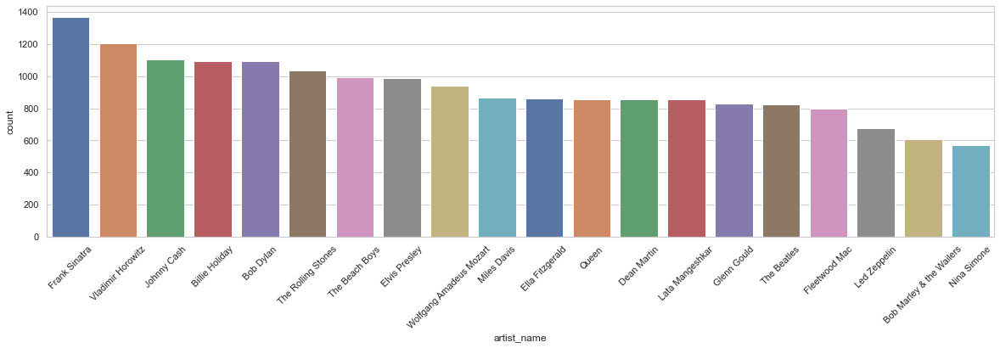

In [36]:
plt.figure(figsize=(20,5))
g=sns.barplot(x='artist_name',y='count',data=top_twenty_song_count,palette='deep')
g.set_xticklabels(g.get_xticklabels(),rotation=45)

In [37]:
top_twenty_popular= artist[['artist_name','popularity']].sort_values('popularity',ascending=False)[0:20]
top_twenty_popular

,artist_name,popularity
5604,El Guincho,81.000000
705,Billie Eilish,77.507042
985,Harry Styles,77.038462
5769,Sammy,77.000000
3777,Benny Blanco,76.833333
5686,Andra Day,76.000000
3933,Snow,74.800000
5660,Absofacto,74.000000
5853,Jaira Burns,74.000000
3413,Lukas Graham,73.500000


[Text(0, 0, 'El Guincho'),
 Text(0, 0, 'Billie Eilish'),
 Text(0, 0, 'Harry Styles'),
 Text(0, 0, 'Sammy'),
 Text(0, 0, 'Benny Blanco'),
 Text(0, 0, 'Andra Day'),
 Text(0, 0, 'Snow'),
 Text(0, 0, 'Absofacto'),
 Text(0, 0, 'Jaira Burns'),
 Text(0, 0, 'Lukas Graham'),
 Text(0, 0, 'CNCO'),
 Text(0, 0, 'Dua Lipa'),
 Text(0, 0, 'Ikon'),
 Text(0, 0, 'Yungblud'),
 Text(0, 0, 'Michelle Williams'),
 Text(0, 0, 'Camila Cabello'),
 Text(0, 0, 'Zara Larsson'),
 Text(0, 0, 'Inner Circle'),
 Text(0, 0, 'TGT'),
 Text(0, 0, 'Tal Bachman')]

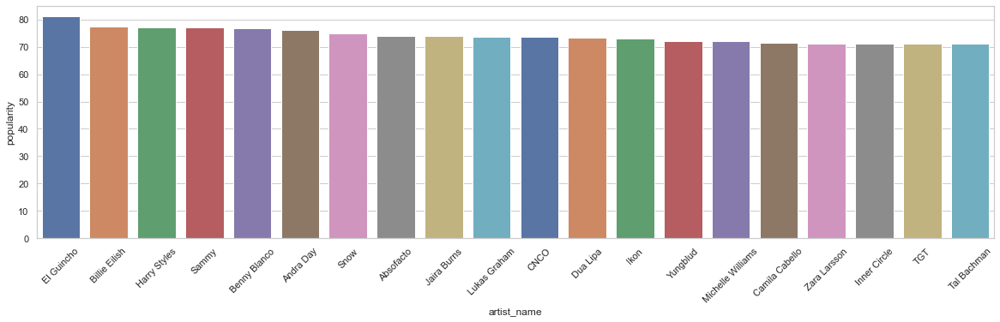

In [38]:
plt.figure(figsize=(20,5))
g=sns.barplot(x='artist_name',y='popularity',data=top_twenty_popular,palette='deep')
g.set_xticklabels(g.get_xticklabels(),rotation=45)

In [39]:
two_thousand = filtered_genre[filtered_genre['year']>=2000]
two_thousand

,artist_names,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,explicit,duration_ms,popularity,year,song_title,Genre,decade,is_popular
0,"""Fat Freddy's Drop""",0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.58500,0.0921,0.0498,0,437200,54,2005,Ernie,Electronic,2000,1
2,"""Fat Freddy's Drop""",0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.34500,0.3060,0.0377,0,431293,55,2009,The Raft,Electronic,2000,1
128,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,0,243013,57,2008,What You Got - Main,R&B;,2000,1
129,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,0,243013,57,2008,What You Got - Main,R&B;,2000,1
130,"""Colby O'Donis""",0.773,0.639,0.310,119.970,-6.738,1,1,0.03330,0.00000,0.1660,0.0380,0,243240,44,2008,What You Got (feat. Akon),R&B;,2000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99328,'Zion & Lennox',0.686,0.877,0.877,192.008,-5.848,1,8,0.00221,0.24300,0.1080,0.1310,0,210024,54,2004,Doncella,Latin,2000,1
99329,'Zion & Lennox',0.807,0.781,0.536,95.009,-6.028,1,1,0.07840,0.00000,0.1050,0.1580,0,192000,56,2004,Bandida,Latin,2000,1
99390,'ZZ Top',0.469,0.532,0.520,160.914,-15.666,0,9,0.01280,0.12500,0.1180,0.0609,0,234107,37,2005,La Grange,Pop/Rock,2000,0
99448,'ZZ Top',0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.03490,0.1320,0.2290,0,232533,56,2004,La Grange - **** Remaster,Pop/Rock,2000,1


In [114]:
two_thousand.to_csv('two_thousand.csv', index=False)

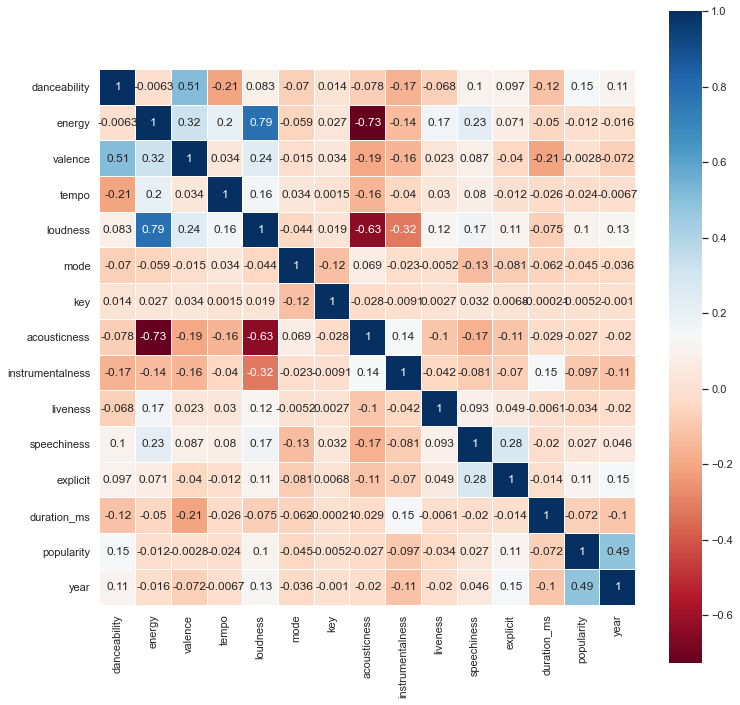

In [40]:
colormap=plt.cm.RdBu
plt.figure(figsize=(12,12))
sns.heatmap(two_thousand.drop(columns=['artist_names','Genre','decade','is_popular','song_title']).astype(float).corr(),linewidths=0.1,cmap=colormap,vmax=1.0,square=True,annot=True)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002515A53CFC8>,
      dtype=object)

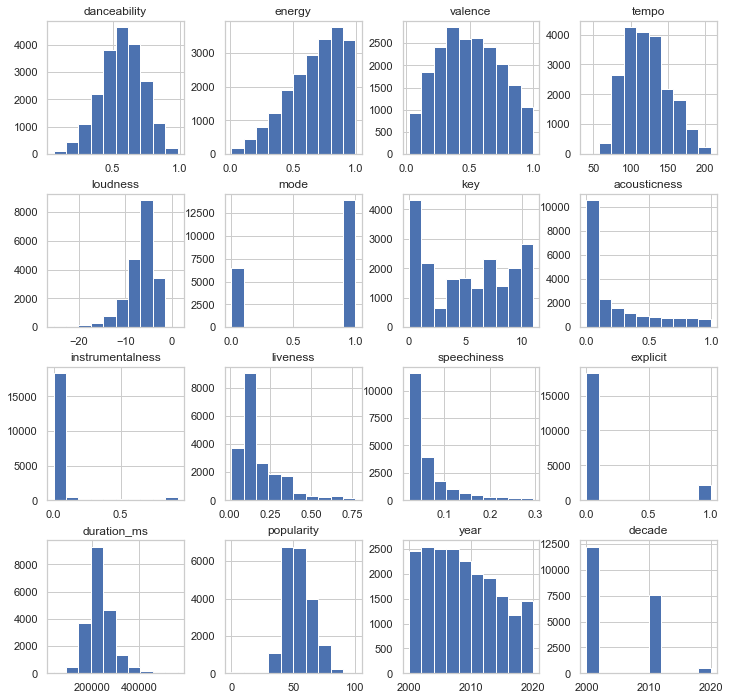

In [41]:
#hist on filtered data
two_thousand.hist(figsize=(12,12))

Text(0.5, 0, 'Year')

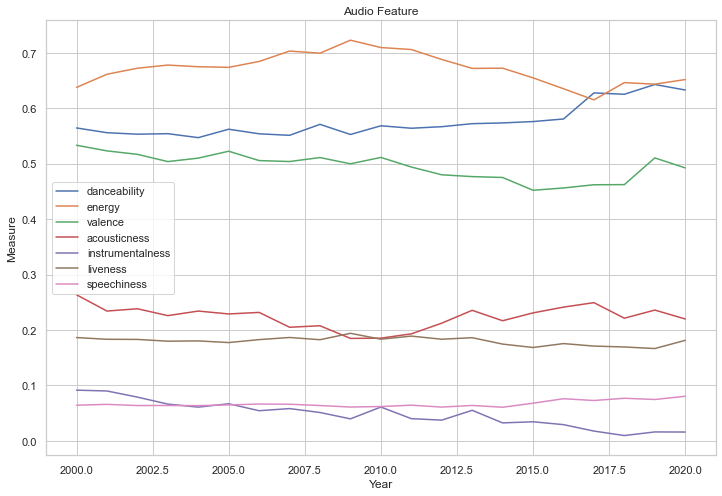

In [42]:
plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")
columns = ["danceability","energy","valence","acousticness","instrumentalness","liveness","speechiness"]
for col in columns:
    x = two_thousand.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('Audio Feature')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0.5, 0, 'Year')

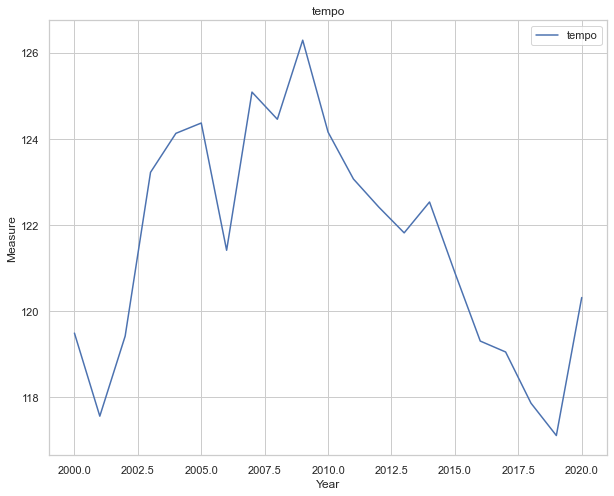

In [43]:
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
columns = ["tempo"]
for col in columns:
    x = two_thousand.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('tempo')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0.5, 0, 'Year')

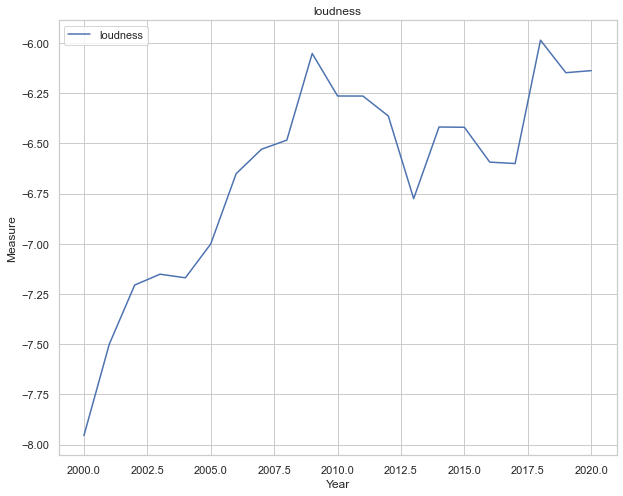

In [44]:
plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
columns = ["loudness"]
for col in columns:
    x = two_thousand.groupby("year")[col].mean()
    ax= sns.lineplot(x=x.index,y=x,label=col)
ax.set_title('loudness')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

In [45]:
key_type = pd.DataFrame(two_thousand["key"].value_counts())
# key_type['Tonal_Counterparts'] = key_type.index.to_series().map(key_class)
key_type = key_type.sort_index()
key_type

,key
0,2421
1,1888
2,2183
3,644
4,1643
5,1659
6,1336
7,2319
8,1412
9,2008


C:\Users\yuuna\anaconda3\envs\PythonData\lib\site-packages\ipykernel_launcher.py:2: MatplotlibDeprecationWarning:

Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.



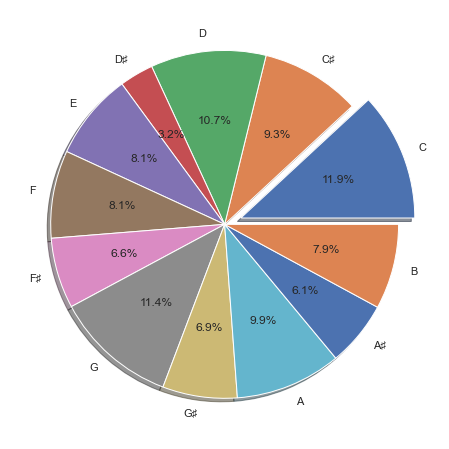

In [46]:
plt.subplots(figsize=(12, 8))
plt.pie(key_type,labels=["C", "C♯", "D", "D♯", "E", "F", "F♯", "G", "G♯", "A", "A♯", "B"],autopct='%1.1f%%',shadow=True,explode=[0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
plt.show()

In [47]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

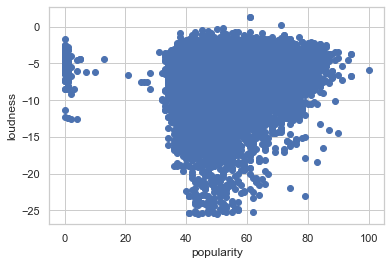

In [48]:
plt.scatter(two_thousand.popularity, two_thousand.loudness)
plt.xlabel('popularity')
plt.ylabel('loudness')
plt.show()

In [49]:
X = two_thousand.popularity.values.reshape(-1, 1)

In [50]:
X[:5]

array([[54],
       [55],
       [57],
       [57],
       [44]], dtype=int64)

In [51]:
X.shape

(20356, 1)

In [52]:
y = two_thousand.loudness

In [53]:
model = LinearRegression()
model.fit(X, y)
y_pred = model.predict(X)
print(y_pred.shape)

(20356,)


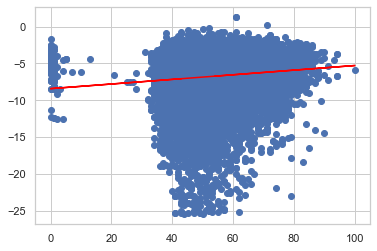

In [54]:
plt.scatter(X, y)
plt.plot(X, y_pred, color='red')
plt.show()

In [55]:
print(model.coef_)
print(model.intercept_)

[0.03145156]
-8.431749986817856


# K-means Algorithm

In [56]:
filtered_genre.columns

Index(['artist_names', 'danceability', 'energy', 'valence', 'tempo',
       'loudness', 'mode', 'key', 'acousticness', 'instrumentalness',
       'liveness', 'speechiness', 'explicit', 'duration_ms', 'popularity',
       'year', 'song_title', 'Genre', 'decade', 'is_popular'],
      dtype='object')

In [57]:
songs_cpa = two_thousand.drop(['artist_names','decade','explicit','year','song_title','decade','is_popular'],axis=1)
songs_cpa['duration_ms'] = songs_cpa['duration_ms']/1000
songs_cpa

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,Genre
0,0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.58500,0.0921,0.0498,437.200,54,Electronic
2,0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.34500,0.3060,0.0377,431.293,55,Electronic
128,0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,R&B;
129,0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,R&B;
130,0.773,0.639,0.310,119.970,-6.738,1,1,0.03330,0.00000,0.1660,0.0380,243.240,44,R&B;
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99328,0.686,0.877,0.877,192.008,-5.848,1,8,0.00221,0.24300,0.1080,0.1310,210.024,54,Latin
99329,0.807,0.781,0.536,95.009,-6.028,1,1,0.07840,0.00000,0.1050,0.1580,192.000,56,Latin
99390,0.469,0.532,0.520,160.914,-15.666,0,9,0.01280,0.12500,0.1180,0.0609,234.107,37,Pop/Rock
99448,0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.03490,0.1320,0.2290,232.533,56,Pop/Rock


In [59]:
from sklearn.cluster import KMeans
# Initializing model with K = 3 (since we already know there are three classes of iris plants)
model = KMeans(n_clusters=19, random_state=5)
model

KMeans(n_clusters=19, random_state=5)

In [60]:
songs_cpa['Genre'].unique()

array(['Electronic', 'R&B;', 'Pop/Rock', 'Country', 'Blues', 'New Age',
       'International', 'Reggae', 'Folk', 'Religious', 'Latin', 'Jazz',
       'Classical', 'Vocal', 'Stage & Screen', 'Avant-Garde',
       "Children's", 'Easy Listening', 'Comedy/Spoken'], dtype=object)

In [61]:
genres_num = {
   "Electronic": 1,
   "R&B;": 2,
   "Pop/Rock": 3,
   "Country": 4,
   "Blues": 5,
   "New Age": 6,
   "International": 7,
   "Reggae": 8,
   "Folk": 9,
   "Religious": 10,
   "Latin": 11,
   "Jazz": 12,
    "Classical":13,
    "Vocal":14,
    "Stage & Screen":15,
    "Avant-Garde":16,
    "Children's":17,
    "Easy Listening":18,
    "Comedy/Spoken":19,
}

In [62]:
songs_cpa["Genre_num"] = songs_cpa["Genre"].apply(lambda x: genres_num[x])

In [63]:
songs_cpa = songs_cpa.drop(["Genre"], axis=1)
songs_cpa.head()

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,Genre_num
0,0.600,0.365,0.131,130.046,-13.083,0,9,0.0672,0.585,0.0921,0.0498,437.200,54,1
2,0.670,0.531,0.336,139.385,-8.267,0,9,0.0156,0.345,0.3060,0.0377,431.293,55,1
128,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000,0.1800,0.0380,243.013,57,2
129,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000,0.1800,0.0380,243.013,57,2
130,0.773,0.639,0.310,119.970,-6.738,1,1,0.0333,0.000,0.1660,0.0380,243.240,44,2


In [64]:
# Fitting model
model.fit(songs_cpa)

KMeans(n_clusters=19, random_state=5)

In [65]:
# Get the predictions
predictions = model.predict(songs_cpa)
print(predictions)

[ 3  3 12 ... 10 10 13]


In [66]:
# Add a new class column to the df_iris
songs_cpa["class"] = model.labels_
songs_cpa.head()

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,Genre_num,class
0,0.600,0.365,0.131,130.046,-13.083,0,9,0.0672,0.585,0.0921,0.0498,437.200,54,1,3
2,0.670,0.531,0.336,139.385,-8.267,0,9,0.0156,0.345,0.3060,0.0377,431.293,55,1,3
128,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000,0.1800,0.0380,243.013,57,2,12
129,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000,0.1800,0.0380,243.013,57,2,12
130,0.773,0.639,0.310,119.970,-6.738,1,1,0.0333,0.000,0.1660,0.0380,243.240,44,2,12


In [67]:
import plotly.express as px
import hvplot.pandas

In [68]:
# Create a scatterplot of df_iris
songs_cpa.hvplot.scatter(x="loudness", y="energy", by="class")

:NdOverlay   [class]
   :Scatter   [loudness]   (energy)

In [69]:
fig=px.scatter_3d(
    songs_cpa,
    x="loudness",
    y="energy",
    z="valence",
    color="class",
    symbol="class",
    size="popularity",
    width=900,
)
fig.update_layout(legend=dict(x=0,y=1))
fig.show()

In [70]:
# Initial imports
import pandas as pd
from sklearn.cluster import KMeans
import plotly.express as px
import hvplot.pandas

In [71]:
# Function to cluster and plot dataset
def test_cluster_amount(df, clusters):
    model = KMeans(n_clusters=clusters, random_state=5)
    model

    # Fitting model
    model.fit(df)

    # Add a new class column to df_iris
    df["class"] = model.labels_

In [72]:
test_cluster_amount(songs_cpa, 19)
songs_cpa.hvplot.scatter(x="energy", y="popularity", by="class")

:NdOverlay   [class]
   :Scatter   [energy]   (popularity)

# Elbow Curve

In [73]:
# Find the best value for K
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(songs_cpa)
    inertia.append(km.inertia_)

# Create the elbow curve
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

In [74]:
def get_clusters(k, data):
   # Create a copy of the DataFrame
   data = data.copy()

   # Initialize the K-Means model
   model = KMeans(n_clusters=k, random_state=0)

   # Fit the model
   model.fit(data)

   # Predict clusters
   predictions = model.predict(data)

   # Create return DataFrame with predicted clusters
   data["class"] = model.labels_

   return data

In [75]:
six_clusters=get_clusters(6,songs_cpa)
six_clusters

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,Genre_num,class
0,0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.58500,0.0921,0.0498,437.200,54,1,3
2,0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.34500,0.3060,0.0377,431.293,55,1,3
128,0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,2,0
129,0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,2,0
130,0.773,0.639,0.310,119.970,-6.738,1,1,0.03330,0.00000,0.1660,0.0380,243.240,44,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99328,0.686,0.877,0.877,192.008,-5.848,1,8,0.00221,0.24300,0.1080,0.1310,210.024,54,11,5
99329,0.807,0.781,0.536,95.009,-6.028,1,1,0.07840,0.00000,0.1050,0.1580,192.000,56,11,1
99390,0.469,0.532,0.520,160.914,-15.666,0,9,0.01280,0.12500,0.1180,0.0609,234.107,37,3,5
99448,0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.03490,0.1320,0.2290,232.533,56,3,5


In [76]:
six_clusters.hvplot.scatter(x="loudness", y="popularity", by="class")

:NdOverlay   [class]
   :Scatter   [loudness]   (popularity)

In [77]:
fig=px.scatter_3d(
    six_clusters,
    x="loudness",
    y="energy",
    z="valence",
    color="class",
    symbol="class",
    size="popularity",
    width=900,
)
fig.update_layout(legend=dict(x=0,y=1))
fig.show()

# Principal Component Analysis

In [78]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import hvplot.pandas

In [79]:
songs_scaled = StandardScaler().fit_transform(songs_cpa)
print(songs_scaled[0:5])

[[ 2.00419048e-01 -1.42942127e+00 -1.54560661e+00  2.71922546e-01
  -1.93357598e+00 -1.46466414e+00  1.05630838e+00 -5.63913390e-01
   3.01615781e+00 -6.66435857e-01 -3.04906183e-01  3.36625312e+00
   3.34781494e-02 -1.01403197e+00 -9.24793170e-01]
 [ 6.44128484e-01 -6.66843080e-01 -6.87623023e-01  5.88203570e-01
  -4.64367506e-01 -1.46466414e+00  1.05630838e+00 -7.50596801e-01
   1.65305285e+00  9.29712054e-01 -5.40962372e-01  3.26760799e+00
   1.25371516e-01 -1.01403197e+00 -9.24793170e-01]
 [ 1.30969264e+00 -1.61520183e-01 -8.17366882e-01 -6.91827610e-02
   8.18314439e-03  6.82750382e-01 -1.19243607e+00 -6.88730787e-01
  -3.06410540e-01 -1.05153273e-02 -5.35109739e-01  1.23388414e-01
   3.09158250e-01 -6.63085220e-01  6.62066263e-01]
 [ 1.30969264e+00 -1.61520183e-01 -8.17366882e-01 -6.91827610e-02
   8.18314439e-03  6.82750382e-01 -1.19243607e+00 -6.88730787e-01
  -3.06410540e-01 -1.05153273e-02 -5.35109739e-01  1.23388414e-01
   3.09158250e-01 -6.63085220e-01  6.62066263e-01]
 [ 1

In [80]:
# Initialize PCA model
pca = PCA(n_components=2)

In [81]:
# Get two principal components for the iris data.
songs_cpa = pca.fit_transform(songs_scaled)

In [82]:
df_songs_pca = pd.DataFrame(
    data = songs_cpa, columns = ['principal component 1','principal component 2']
)
df_songs_pca.head()

,principal component 1,principal component 2
0,2.625299,1.964282
1,0.609877,1.582934
2,-0.214898,-0.278006
3,-0.214898,-0.278006
4,-0.126866,-0.054165


In [83]:
pca.explained_variance_ratio_

array([0.19521458, 0.10936452])

In [84]:
# Find the best value for K
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(df_songs_pca)
    inertia.append(km.inertia_)

# Create the elbow curve
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

In [85]:
# Initialize the K-means model
model = KMeans(n_clusters=5, random_state=0)

# Fit the model
model.fit(df_songs_pca)

# Predict clusters
predictions = model.predict(df_songs_pca)

# Add the predicted class columns
df_songs_pca["class"] = model.labels_
df_songs_pca.head()

,principal component 1,principal component 2,class
0,2.625299,1.964282,2
1,0.609877,1.582934,4
2,-0.214898,-0.278006,3
3,-0.214898,-0.278006,3
4,-0.126866,-0.054165,3


In [86]:
df_songs_pca.hvplot.scatter(
    x="principal component 1",
    y="principal component 2",
    hover_cols=["class"],
    by="class",
)

:NdOverlay   [class]
   :Scatter   [principal component 1]   (principal component 2,class)

# Principal Component Analysis 2

In [87]:
song_cpa = two_thousand.drop(['decade','explicit','year','song_title','decade','is_popular'],axis=1)
song_cpa['duration_ms'] = song_cpa['duration_ms']/1000
song_cpa

,artist_names,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,Genre
0,"""Fat Freddy's Drop""",0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.58500,0.0921,0.0498,437.200,54,Electronic
2,"""Fat Freddy's Drop""",0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.34500,0.3060,0.0377,431.293,55,Electronic
128,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,R&B;
129,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57,R&B;
130,"""Colby O'Donis""",0.773,0.639,0.310,119.970,-6.738,1,1,0.03330,0.00000,0.1660,0.0380,243.240,44,R&B;
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99328,'Zion & Lennox',0.686,0.877,0.877,192.008,-5.848,1,8,0.00221,0.24300,0.1080,0.1310,210.024,54,Latin
99329,'Zion & Lennox',0.807,0.781,0.536,95.009,-6.028,1,1,0.07840,0.00000,0.1050,0.1580,192.000,56,Latin
99390,'ZZ Top',0.469,0.532,0.520,160.914,-15.666,0,9,0.01280,0.12500,0.1180,0.0609,234.107,37,Pop/Rock
99448,'ZZ Top',0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.03490,0.1320,0.2290,232.533,56,Pop/Rock


In [88]:
genre_name=song_cpa[["Genre"]]
genre_name

,Genre
0,Electronic
2,Electronic
128,R&B;
129,R&B;
130,R&B;
...,...
99328,Latin
99329,Latin
99390,Pop/Rock
99448,Pop/Rock


In [89]:
artist_name=song_cpa[["artist_names"]]
artist_name

,artist_names
0,"""Fat Freddy's Drop"""
2,"""Fat Freddy's Drop"""
128,"""Colby O'Donis"", 'Akon'"
129,"""Colby O'Donis"", 'Akon'"
130,"""Colby O'Donis"""
...,...
99328,'Zion & Lennox'
99329,'Zion & Lennox'
99390,'ZZ Top'
99448,'ZZ Top'


In [90]:
song_cpa.drop(columns=["Genre"], inplace=True)
song_cpa

,artist_names,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity
0,"""Fat Freddy's Drop""",0.600,0.365,0.131,130.046,-13.083,0,9,0.06720,0.58500,0.0921,0.0498,437.200,54
2,"""Fat Freddy's Drop""",0.670,0.531,0.336,139.385,-8.267,0,9,0.01560,0.34500,0.3060,0.0377,431.293,55
128,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57
129,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.03270,0.00000,0.1800,0.0380,243.013,57
130,"""Colby O'Donis""",0.773,0.639,0.310,119.970,-6.738,1,1,0.03330,0.00000,0.1660,0.0380,243.240,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99328,'Zion & Lennox',0.686,0.877,0.877,192.008,-5.848,1,8,0.00221,0.24300,0.1080,0.1310,210.024,54
99329,'Zion & Lennox',0.807,0.781,0.536,95.009,-6.028,1,1,0.07840,0.00000,0.1050,0.1580,192.000,56
99390,'ZZ Top',0.469,0.532,0.520,160.914,-15.666,0,9,0.01280,0.12500,0.1180,0.0609,234.107,37
99448,'ZZ Top',0.552,0.651,0.533,161.548,-10.624,0,4,0.00494,0.03490,0.1320,0.2290,232.533,56


In [91]:
X = pd.get_dummies(song_cpa, columns=["artist_names"])
X.head(10)

,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,...,"artist_names_'Zion & Lennox', 'J Balvin'",artist_names_'blink-182',"artist_names_'blink-182', 'Robert Smith'",artist_names_'dc Talk',artist_names_'gnash',artist_names_'k.d. lang',artist_names_'kidneythieves',artist_names_'mewithoutYou',artist_names_'moe.',artist_names_'t.A.T.u.'
0,0.600,0.365,0.131,130.046,-13.083,0,9,0.0672,0.585000,0.0921,...,0,0,0,0,0,0,0,0,0,0
2,0.670,0.531,0.336,139.385,-8.267,0,9,0.0156,0.345000,0.3060,...,0,0,0,0,0,0,0,0,0,0
128,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000000,0.1800,...,0,0,0,0,0,0,0,0,0,0
129,0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000000,0.1800,...,0,0,0,0,0,0,0,0,0,0
130,0.773,0.639,0.310,119.970,-6.738,1,1,0.0333,0.000000,0.1660,...,0,0,0,0,0,0,0,0,0,0
132,0.638,0.395,0.316,78.516,-11.299,0,4,0.7240,0.569000,0.0761,...,0,0,0,0,0,0,0,0,0,0
141,0.726,0.330,0.378,94.755,-9.935,1,9,0.6080,0.127000,0.7240,...,0,0,0,0,0,0,0,0,0,0
143,0.765,0.550,0.688,94.959,-7.942,1,0,0.3560,0.000095,0.1020,...,0,0,0,0,0,0,0,0,0,0
145,0.813,0.446,0.603,82.587,-11.328,0,1,0.1300,0.040500,0.0865,...,0,0,0,0,0,0,0,0,0,0
146,0.786,0.547,0.683,92.603,-11.416,1,1,0.0397,0.272000,0.0378,...,0,0,0,0,0,0,0,0,0,0


In [92]:
X_scaled = StandardScaler().fit_transform(X)
X_scaled[0:5]

array([[ 0.20041905, -1.42942127, -1.54560661, ..., -0.01214078,
        -0.0140193 , -0.01717091],
       [ 0.64412848, -0.66684308, -0.68762302, ..., -0.01214078,
        -0.0140193 , -0.01717091],
       [ 1.30969264, -0.16152018, -0.81736688, ..., -0.01214078,
        -0.0140193 , -0.01717091],
       [ 1.30969264, -0.16152018, -0.81736688, ..., -0.01214078,
        -0.0140193 , -0.01717091],
       [ 1.29701523, -0.17070787, -0.79644045, ..., -0.01214078,
        -0.0140193 , -0.01717091]])

In [93]:
# Using PCA to reduce dimension to three principal components.
# YOUR CODE HERE
# Initialize PCA model
pca = PCA(n_components=3)
crypto_pca = pca.fit_transform(X_scaled)
crypto_pca

array([[ 3.16844241,  2.54116673,  5.44780885],
       [ 1.34596567,  2.2174119 ,  4.92508979],
       [-0.11133022, -0.6291117 , -0.52108588],
       ...,
       [ 1.22391292,  0.60345849,  1.43903502],
       [-0.57866546,  0.06825395,  2.034042  ],
       [-1.04085813, -0.25393624, -0.40684084]])

In [94]:
pcs_df=pd.DataFrame(
    data=crypto_pca,columns=['PC 1','PC 2','PC 3'],index=X.index
)
pcs_df

,PC 1,PC 2,PC 3
0,3.168442,2.541167,5.447809
2,1.345966,2.217412,4.925090
128,-0.111330,-0.629112,-0.521086
129,-0.111330,-0.629112,-0.521086
130,-0.002324,-0.374597,-1.131864
...,...,...,...
99328,-2.001554,-0.917197,0.653676
99329,-1.367699,-1.950748,0.662999
99390,1.223913,0.603458,1.439035
99448,-0.578665,0.068254,2.034042


In [95]:
# Create an elbow curve to find the best value for K.
# YOUR CODE HERE
inertia = []
k = list(range(1, 11))
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(pcs_df)
    inertia.append(km.inertia_)

elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

In [96]:
# Initialize the K-Means model.
# YOUR CODE HERE
model = KMeans(n_clusters=6, random_state=0)
# Fit the model
# YOUR CODE HERE
model.fit(pcs_df)
# Predict clusters
# YOUR CODE HERE
predictions = model.predict(pcs_df)
print(predictions)

[2 5 0 ... 5 4 0]


In [97]:
# Create a new DataFrame including predicted clusters and cryptocurrencies features.
# Concatentate the crypto_df and pcs_df DataFrames on the same columns.
# YOUR CODE HERE
clustered_df=pd.concat([song_cpa,pcs_df],axis=1)
#  Add a new column, "CoinName" to the clustered_df DataFrame that holds the names of the cryptocurrencies. 
# YOUR CODE HERE
clustered_df=pd.concat([clustered_df,genre_name],axis=1)
#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
# YOUR CODE HERE
clustered_df['Class']= model.labels_
# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(20356, 19)


,artist_names,danceability,energy,valence,tempo,loudness,mode,key,acousticness,instrumentalness,liveness,speechiness,duration_ms,popularity,PC 1,PC 2,PC 3,Genre,Class
0,"""Fat Freddy's Drop""",0.600,0.365,0.131,130.046,-13.083,0,9,0.0672,0.585000,0.0921,0.0498,437.200,54,3.168442,2.541167,5.447809,Electronic,2
2,"""Fat Freddy's Drop""",0.670,0.531,0.336,139.385,-8.267,0,9,0.0156,0.345000,0.3060,0.0377,431.293,55,1.345966,2.217412,4.925090,Electronic,5
128,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000000,0.1800,0.0380,243.013,57,-0.111330,-0.629112,-0.521086,R&B;,0
129,"""Colby O'Donis"", 'Akon'",0.775,0.641,0.305,119.974,-6.718,1,1,0.0327,0.000000,0.1800,0.0380,243.013,57,-0.111330,-0.629112,-0.521086,R&B;,0
130,"""Colby O'Donis""",0.773,0.639,0.310,119.970,-6.738,1,1,0.0333,0.000000,0.1660,0.0380,243.240,44,-0.002324,-0.374597,-1.131864,R&B;,0
132,"""D'Angelo""",0.638,0.395,0.316,78.516,-11.299,0,4,0.7240,0.569000,0.0761,0.1000,344.347,57,3.269476,-0.416193,4.038712,R&B;,2
141,"""D'Angelo""",0.726,0.330,0.378,94.755,-9.935,1,9,0.6080,0.127000,0.7240,0.2110,373.600,42,1.620117,-0.336624,3.733250,R&B;,4
143,"""D'Angelo""",0.765,0.550,0.688,94.959,-7.942,1,0,0.3560,0.000095,0.1020,0.0800,240.453,50,0.787277,-1.733323,1.629666,R&B;,4
145,"""D'Angelo""",0.813,0.446,0.603,82.587,-11.328,0,1,0.1300,0.040500,0.0865,0.2430,455.067,41,0.946470,-1.018390,5.113904,R&B;,4
146,"""D'Angelo""",0.786,0.547,0.683,92.603,-11.416,1,1,0.0397,0.272000,0.0378,0.2620,302.840,55,0.600570,-1.414664,3.733946,R&B;,4


In [98]:
# Creating a 3D-Scatter with the PCA data and the clusters
# YOUR CODE HERE
fig = px.scatter_3d(clustered_df,x="Genre",y="loudness",z="popularity",color="Class",symbol="Class",width=900)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()

In [99]:
# Scaling data to create the scatter plot with tradable cryptocurrencies.
# YOUR CODE HERE
from sklearn.preprocessing import MinMaxScaler
data = clustered_df[['loudness','energy']].values
trans = MinMaxScaler()
data = trans.fit_transform(data)
data 

array([[0.46313596, 0.35994508],
       [0.64237597, 0.52753044],
       [0.70002605, 0.63858098],
       ...,
       [0.36700287, 0.52853999],
       [0.55465406, 0.64867648],
       [0.66600916, 0.8637107 ]])

In [100]:
# Create a new DataFrame that has the scaled data with the clustered_df DataFrame index.
# YOUR CODE HERE
dataset = pd.DataFrame(data,columns=['loudness','energy'],index=clustered_df.index)
# Add the "CoinName" column from the clustered_df DataFrame to the new DataFrame.
# YOUR CODE HERE
plot_df=pd.concat([dataset,genre_name],axis=1)
# Add the "Class" column from the clustered_df DataFrame to the new DataFrame. 
# YOUR CODE HERE
plot_df['Class']= model.labels_
plot_df.head(10)

,loudness,energy,Genre,Class
0,0.463136,0.359945,Electronic,2
2,0.642376,0.527530,Electronic,5
128,0.700026,0.638581,R&B;,0
129,0.700026,0.638581,R&B;,0
130,0.699282,0.636562,R&B;,0
132,0.529532,0.390232,R&B;,2
141,0.580297,0.324611,R&B;,4
143,0.654472,0.546712,R&B;,4
145,0.528453,0.441719,R&B;,4
146,0.525178,0.543683,R&B;,4


In [101]:
# Create a hvplot.scatter plot using x="TotalCoinsMined" and y="TotalCoinSupply".
# YOUR CODE HERE
plot_df.hvplot.scatter(
    x="loudness",
    y="energy",
    hover_cols=["Class"],
    by="Class",
)

:NdOverlay   [Class]
   :Scatter   [loudness]   (energy,Class)